In [1]:
# Import statements
import numpy as np
import matplotlib.pyplot as plt
from multiprocessing import Pool
import pandas as pd
from statsmodels.tsa.stattools import acf
from scipy.interpolate import interp1d
import glob
import sys
from scipy.stats import nbinom
from PIL import Image

# Setting defatult font family for plots
#plt.rcParams["font.family"] = "Arial"

$R_0 = \dfrac{\beta\delta}{(\delta+\mu)(\gamma+\mu)}\Rightarrow \beta = \dfrac{R_0(\delta+\mu)(\gamma+\mu)}{\delta}$

In [2]:
# Constant Parameters
N = 1e5  # Total population
delta = 1/5 # Symptom onset rate (1/delta is the infectious)
gamma = 1/10  # Recovery rate (1/gamma is the infectious period)
R_0 = 4 # Basic reproduction number estimated for alpha variant
mu = 0.00003424657  # Birth and death rate
initial_infected = 10
initial_exposed = 0
max_time = 200
beta0 = R_0 * (delta+mu)*(gamma+mu)/delta

print(beta0)

beta_trans = 1 * (delta+mu)*(gamma+mu)/delta
print(beta_trans)

0.40020550287655116
0.10005137571913779


## Constant sim: $\beta(t)=\beta_0$
## Increasing sim: $\beta(t)=\beta_0+p*(t-\tau)$
## Decreasing sim: $\beta(t)=\beta_0-p$
## Step sim: $\beta(t)=\beta_0(1-H(t-\tau))+\beta_1(H(t-\tau))$

In [3]:
def long_run_averages(standardised):
    n = len(standardised)
    running_mean = np.zeros(n)
    running_std= np.zeros(n)
    for j in range(n):
        running_mean[j] = np.nanmean(standardised[1:j+1])
        running_std[j] = np.nanstd(standardised[1:j+1])
    return running_std, running_mean

def exceed_threshold_cutoffs(stat_timeseries, ltla):
    std_val = []
    mean_val = []
    running_std, running_mean = long_run_averages(stat_timeseries[ltla].values)
    std_val = np.concatenate((std_val,running_std))
    mean_val = np.concatenate((mean_val,running_mean))
    # Get indices where stat > mean + 2*sigma and indices where stat < mean - 2*sigma
    stat_timeseries = stat_timeseries[ltla].values
    indices_greater = [ n for n,i in enumerate(range(len(stat_timeseries))) if (stat_timeseries[i])>(mean_val+2*std_val)[i] ]
    indices_smaller =  [ n for n,i in enumerate(range(len(stat_timeseries))) if (stat_timeseries[i])<(mean_val-2*std_val)[i] ]
    all_indices = np.setdiff1d(np.unique(indices_greater + indices_smaller ),[1])    
    return all_indices,mean_val,std_val
    
def loop_EWSs_store_results_cutoffs(ews_dict, ltlas):
    indices_dict = {}
    mean_dict = {}
    std_dict = {}
    for stat in ews_dict.keys():
        indices_dict[stat] = {}
        mean_dict[stat] = {}
        std_dict[stat] = {}
        for ltla in ltlas:
            stat_data = ews_dict[stat][ltla].reset_index()
            indices, mean_val, std_val = exceed_threshold_cutoffs(stat_data, ltla)
            indices_dict[stat][ltla] = indices
            mean_dict[stat][ltla] = mean_val
            std_dict[stat][ltla] = std_val
    return indices_dict, mean_dict, std_dict

# Function to normalise EWS for 2-sigma calculations
def pandas_zscore(dataframe):
    rolling_mean = dataframe.expanding().mean()
    rolling_std = dataframe.expanding().std(ddof=0)
    normalise_stats = (dataframe - rolling_mean)/rolling_std
    return normalise_stats

# Function to calculate EWS on a rolling window for each column
def calculate_ews_rolling(wide_data, window_size):
    ews_data = {}
    rolling = wide_data.rolling(window=window_size,center=False, min_periods=1)
    # variance = (wide_data**2).rolling(window=window_size,center=False, min_periods=1).mean()
    variance = rolling.var()
    ews_data['variance'] = variance
    normalised_ews_data = {}
    for ews in ews_data.keys():
        normalised_ews_data[ews] = pandas_zscore(ews_data[ews])
    return ews_data, normalised_ews_data

# Get detect indices for timeline
from operator import itemgetter

def detect(arr, times, n):
    if len(arr) < n:
        return []
    time = []
    values = []
    i = 0
    while i < len(arr) - (n - 1):
        if all(arr[i + j] + 1 == arr[i + j + 1] for j in range(n - 1)):
            values.append(arr[i + n - 1])
            time.append(times[arr[i + n -1]])
            # Skip to the end of this sequence of consecutive numbers
            while i + n - 1 < len(arr) - 1 and arr[i + n - 1] + 1 == arr[i + n]:
                i += 1
        i += 1
    return time

In [4]:
const_files = glob.glob('Cases/alpha/constant/C*.npy')
for i, file in enumerate(const_files):
    I_constant = np.load(file) if i == 0 else np.vstack((I_constant,np.load(file)))
    R_file = file.replace('C_','R_')
    Reff_constant = np.load(R_file) if i == 0 else np.vstack((Reff_constant,np.load(R_file)))
increasing_files = glob.glob('Cases/alpha/increasing/C*.npy')
for i, file in enumerate(increasing_files):
    I_increasing = np.load(file) if i == 0 else np.vstack((I_increasing,np.load(file)))
    R_file = file.replace('C_','R_')
    Reff_increasing = np.load(R_file) if i == 0 else np.vstack((Reff_increasing,np.load(R_file)))
decreasing_files = glob.glob('Cases/alpha/decreasing/C*.npy')
for i, file in enumerate(decreasing_files):
    I_decreasing = np.load(file) if i == 0 else np.vstack((I_decreasing,np.load(file)))
    R_file = file.replace('C_','R_')
    Reff_decreasing = np.load(R_file) if i == 0 else np.vstack((Reff_decreasing,np.load(R_file)))
step_files = glob.glob('Cases/alpha/step/C*.npy')
for i, file in enumerate(step_files):
    I_step = np.load(file) if i == 0 else np.vstack((I_step,np.load(file)))
    R_file = file.replace('C_','R_')
    Reff_step = np.load(R_file) if i == 0 else np.vstack((Reff_step,np.load(R_file)))
days = np.arange(0,max_time+0.1,1)

In [5]:
max_time = 200
days = np.arange(0,max_time+0.1,1)
times = np.arange(0,max_time+0.1,0.1)
tau = 30
num_res = 10000

drop_list = []
for i in range(np.shape(I_increasing)[0]):
    if Reff_increasing[i,1900] >= 3.75:
        drop_list.append(i)
I_increasing = np.delete(I_increasing, drop_list,axis=0)
Reff_increasing = np.delete(Reff_increasing, drop_list,axis=0)

num_res_inc = len(I_increasing)
print(num_res_inc)

4375


In [6]:
I_constant = I_constant[:10000,:]
I_decreasing = I_decreasing[:10000,:]
I_increasing = I_increasing[:num_res_inc,:]
I_step = I_step[:10000,:]
Reff_constant = Reff_constant[:10000,:]
Reff_decreasing = Reff_decreasing[:10000,:]
Reff_increasing = Reff_increasing[:num_res_inc,:]
Reff_step = Reff_step[:10000,:]

In [7]:
constant_crit = np.mean(times[np.where(np.abs(np.mean(Reff_constant,axis=0)-1)<=1e-2)])
inc_crit_up = np.mean(times[np.where(np.abs(np.mean(Reff_increasing,axis=0)-1)<=1e-2)][:5])
inc_crit_down = np.mean(times[np.where(np.abs(np.mean(Reff_increasing,axis=0)-1)<=1e-2)][5:])
dec_crit = np.mean(times[np.where(np.abs(np.mean(Reff_decreasing,axis=0)-1)<=1e-2)])
step_crit = tau

In [8]:
rho = 0.8
phi = 1  # scalar overdispersion
n = phi
mu = np.diff(I_constant) * rho  # shape: (10000, 200)
p = phi / (phi + mu)

In [9]:
rho = 0.8
phi = 1  # scalar overdispersion
n = phi
mu = np.diff(I_constant) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_cst = df.sub(df.mean(axis = 1), axis = 'rows')
mu = np.diff(I_step) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df_step = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_step = df_step.sub(df_step.mean(axis = 1), axis = 'rows')
mu = np.diff(I_increasing) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df_increasing = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_inc = df_increasing.sub(df_increasing.mean(axis = 1), axis = 'rows')
mu = np.diff(I_decreasing) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df_decreasing = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_dec = df_decreasing.sub(df_decreasing.mean(axis = 1), axis = 'rows')

In [10]:
import pickle
if False:
    cst, cst_norm = calculate_ews_rolling(stoch_cst, 7)
    inc, inc_norm = calculate_ews_rolling(stoch_inc, 7)
    dec, dec_norm = calculate_ews_rolling(stoch_dec, 7)
    step, step_norm = calculate_ews_rolling(stoch_step, 7)

    ind_cst, mean_cst, std_cst = loop_EWSs_store_results_cutoffs(cst_norm,np.arange(num_res))
    ind_inc, mean_inc, std_inc = loop_EWSs_store_results_cutoffs(inc_norm,np.arange(num_res_inc))
    ind_dec, mean_dec, std_dec = loop_EWSs_store_results_cutoffs(dec_norm,np.arange(num_res))
    ind_step, mean_step, std_step = loop_EWSs_store_results_cutoffs(step_norm,np.arange(num_res))
    times_cst = {}
    times_inc = {}
    times_dec = {}
    times_step = {}

    for sim in np.arange(num_res):
        times_cst[sim] = detect(ind_cst['variance'][sim],days,3)
        times_dec[sim] = detect(ind_dec['variance'][sim],days,3)
        times_step[sim] = detect(ind_step['variance'][sim],days,3)

    for sim in np.arange(num_res_inc):
        times_inc[sim] = detect(ind_inc['variance'][sim],days,3)
    with open('Cases/times_const_alpha.pkl','wb') as output:
        pickle.dump(times_cst, output)
    with open('Cases/times_inc_alpha.pkl','wb') as output:
        pickle.dump(times_inc, output)
    with open('Cases/times_dec_alpha.pkl','wb') as output:
        pickle.dump(times_dec, output)
    with open('Cases/times_step_alpha.pkl','wb') as output:
        pickle.dump(times_step, output)
else:
    with open('Cases/times_const_alpha801.pkl','rb') as output:
        times_cst = pickle.load(output)
    with open('Cases/times_inc_alpha801.pkl','rb') as output:
        times_inc = pickle.load(output)
    with open('Cases/times_dec_alpha801.pkl','rb') as output:
        times_dec = pickle.load(output)
    with open('Cases/times_step_alpha801.pkl','rb') as output:
        times_step = pickle.load(output)

In [ ]:
def norm(x):
    rolling_mean = x.expanding().mean()
    rolling_std = x.expanding().std(ddof=0)
    return (x-rolling_mean)/rolling_std

C_constant = np.diff(I_constant)
C_increasing = np.diff(I_increasing)
C_decreasing = np.diff(I_decreasing)
C_step = np.diff(I_step)

fig, axs = plt.subplots(nrows = 4, ncols = 4, figsize=(24,16),sharex=True)
for i in range(num_res):
    axs[0,0].plot(days[1:],df[i],color='#629FCA',alpha=0.1)
    axs[0,1].plot(times,Reff_constant[i],color='#629FCA',alpha=0.1)
axs[0,2].plot(days[1:],stoch_cst.var(axis=1).values,color='#629FCA',label='Simulation')
axs[0,3].boxplot([j for i in times_cst.values() for j in i],vert=False)

for ax in axs[0,:]:
    twin = ax.twinx()
    twin.vlines(constant_crit,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

for i in range(num_res_inc):
    axs[1,0].plot(days[1:],df_increasing[i],color='#629FCA',alpha=0.1)
    axs[1,1].plot(times,Reff_increasing[i],color='#629FCA',alpha=0.1)
axs[1,2].plot(days[1:],stoch_inc.var(axis=1).values,color='#629FCA')
axs[1,3].boxplot([j for i in times_inc.values() for j in i],vert=False)

for ax in axs[1,:]:
    twin = ax.twinx()
    twin.vlines(inc_crit_up,ymin=0,ymax=1,color='k',linestyle='--')
    twin.vlines(inc_crit_down,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

for i in range(num_res):
    axs[2,0].plot(days[1:],df_decreasing[i],color='#629FCA',alpha=0.1)
    axs[2,1].plot(times,Reff_decreasing[i],color='#629FCA',alpha=0.1)
axs[2,2].plot(days[1:],stoch_dec.var(axis=1).values,color='#629FCA')
axs[2,3].boxplot([j for i in times_dec.values() for j in i],vert=False)

for ax in axs[2,:]:
    twin = ax.twinx()
    twin.vlines(dec_crit,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

for i in range(num_res):
    axs[3,0].plot(days[1:],df_step[i],color='#629FCA',alpha=0.1)
    axs[3,1].plot(times,Reff_step[i],color='#629FCA',alpha=0.1)
axs[3,0].set_xlabel('Time (days)',fontsize=16)
axs[3,1].set_xlabel('Time (days)',fontsize=16)
axs[3,2].plot(days[1:],stoch_step.var(axis=1).values,color='#629FCA')
axs[3,2].set_xlabel('Time (days)',fontsize=16)  
axs[3,3].boxplot([j for i in times_step.values() for j in i],vert=False)
axs[3,3].set_xlabel('Time (days)',fontsize=16)

for ax in axs[3,:]:
    twin = ax.twinx()
    twin.vlines(step_crit,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

axs[0,0].set_title('Number of cases',fontsize=18)
axs[0,1].set_title(r'$R_t$',fontsize=18)
axs[0,2].set_title('Variance between detrended sims',fontsize=18)
axs[0,3].set_title('Time-of-detection boxplot',fontsize=18)

labels= [r'Constant $\beta(t)$',r'Increasing $\beta(t)$', r'Decreasing $\beta(t)$', r'Step decrease in $\beta(t)$']
for i in range(4):
    for j in range(4):
        axs[i,j].tick_params(axis='x', labelsize=14)
        axs[i,j].tick_params(axis='y', labelsize=14)
        if j == 2:
            axs[i,j].set_ylim(bottom=0)
        if j == 3:
            axs[i,j].set_yticks([])
        if j == 0:
            axs[i,j].set_ylim((0,axs[i,j].get_ylim()[-1]))
        axs[i,j].set_xlim((0,200))
# for i in range(4):
#     axs[i,0].set_ylim([0,up_lims_p[i]])
#     axs[i,1].set_ylim([0,4.1])
#     axs[i,2].set_ylim([0,up_lims[i]])
#     axs[i,2].ticklabel_format(axis='y',style='sci',scilimits=(0,0))
#     axs[i,0].set_ylabel(labels[i],fontsize=18)
#     axs[i,0].get_yaxis().set_label_coords(-0.15,0.5)

iax = axs[1,2].inset_axes([0.1, 0.5, 0.5, 0.5])  # [left, bottom, width, height]
iax.plot(days[1:61],stoch_inc.var(axis=1).values[:60],color='#629FCA')
twin = iax.twinx()
twin.vlines(inc_crit_up,ymin=0,ymax=1,color='k',linestyle='--')
twin.set_ylim((0,1))

plt.tight_layout()
plt.savefig("Figures/cases_alpha_801.png",dpi=300,bbox_inches='tight')
#plt.savefig("Figures/Sub_format/Fig6.tiff", dpi=300, pil_kwargs={"compression": "tiff_lzw"})
plt.show()

In [14]:
num = 0
for i in range(len(times_inc)):
    if any(times_inc[i] <= inc_crit_up):
        num += 1
print(num / len(times_inc)) #0.1259124087591241
num = 0
for i in range(len(times_inc)):
    if any(times_inc[i] >= inc_crit_down) :
        num += 1
print(num / len(times_inc)) #0.0009124087591240876

0.1259124087591241
0.0009124087591240876


In [7]:
from scipy.stats import nbinom
rho = 0.6
phi = 1  # scalar overdispersion
n = phi
mu = np.diff(I_constant) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_cst = df.sub(df.mean(axis = 1), axis = 'rows')
mu = np.diff(I_step) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df_step = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_step = df_step.sub(df_step.mean(axis = 1), axis = 'rows')
mu = np.diff(I_increasing) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df_increasing = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_inc = df_increasing.sub(df_increasing.mean(axis = 1), axis = 'rows')
mu = np.diff(I_decreasing) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df_decreasing = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_dec = df_decreasing.sub(df_decreasing.mean(axis = 1), axis = 'rows')

In [8]:
import pickle
if False:
    cst, cst_norm = calculate_ews_rolling(stoch_cst, 7)
    inc, inc_norm = calculate_ews_rolling(stoch_inc, 7)
    dec, dec_norm = calculate_ews_rolling(stoch_dec, 7)
    step, step_norm = calculate_ews_rolling(stoch_step, 7)

    ind_cst, mean_cst, std_cst = loop_EWSs_store_results_cutoffs(cst_norm,np.arange(num_res))
    ind_inc, mean_inc, std_inc = loop_EWSs_store_results_cutoffs(inc_norm,np.arange(num_res_inc))
    ind_dec, mean_dec, std_dec = loop_EWSs_store_results_cutoffs(dec_norm,np.arange(num_res))
    ind_step, mean_step, std_step = loop_EWSs_store_results_cutoffs(step_norm,np.arange(num_res))
    times_cst = {}
    times_inc = {}
    times_dec = {}
    times_step = {}

    for sim in np.arange(num_res):
        times_cst[sim] = detect(ind_cst['variance'][sim],days,3)
        times_dec[sim] = detect(ind_dec['variance'][sim],days,3)
        times_step[sim] = detect(ind_step['variance'][sim],days,3)

    for sim in np.arange(num_res_inc):
        times_inc[sim] = detect(ind_inc['variance'][sim],days,3)
    with open('Cases/times_const_alpha601.pkl','wb') as output:
        pickle.dump(times_cst, output)
    with open('Cases/times_inc_alpha601.pkl','wb') as output:
        pickle.dump(times_inc, output)
    with open('Cases/times_dec_alpha601.pkl','wb') as output:
        pickle.dump(times_dec, output)
    with open('Cases/times_step_alpha601.pkl','wb') as output:
        pickle.dump(times_step, output)
else:
    with open('Cases/times_const_alpha601.pkl','rb') as output:
        times_cst = pickle.load(output)
    with open('Cases/times_inc_alpha601.pkl','rb') as output:
        times_inc = pickle.load(output)
    with open('Cases/times_dec_alpha601.pkl','rb') as output:
        times_dec = pickle.load(output)
    with open('Cases/times_step_alpha601.pkl','rb') as output:
        times_step = pickle.load(output)

/tmp/ipykernel_549556/261496722.py:90: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


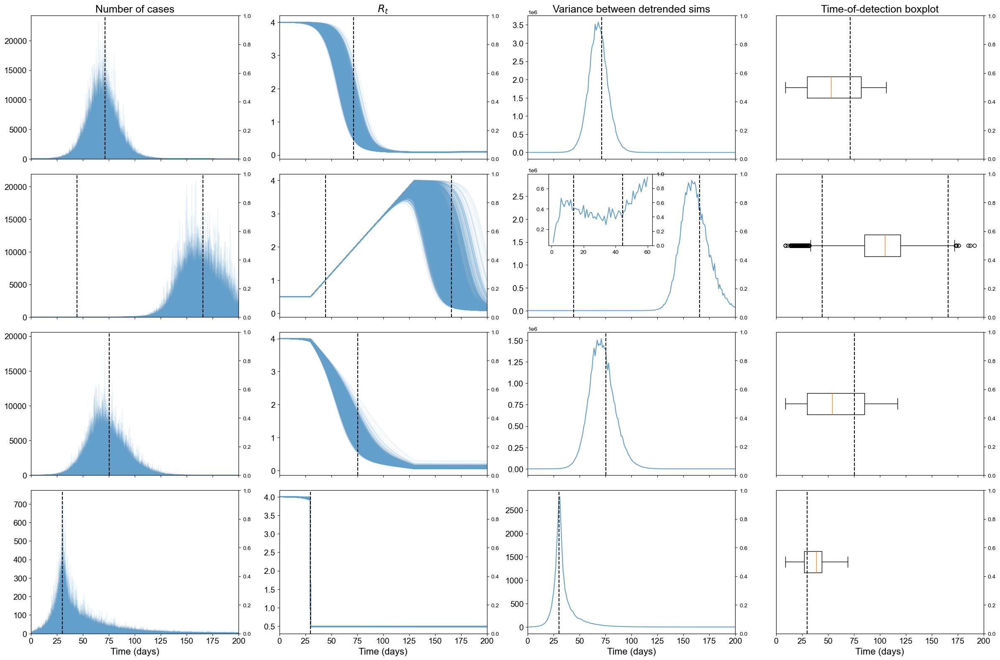

In [ ]:
def norm(x):
    rolling_mean = x.expanding().mean()
    rolling_std = x.expanding().std(ddof=0)
    return (x-rolling_mean)/rolling_std

C_constant = np.diff(I_constant)
C_increasing = np.diff(I_increasing)
C_decreasing = np.diff(I_decreasing)
C_step = np.diff(I_step)

fig, axs = plt.subplots(nrows = 4, ncols = 4, figsize=(24,16),sharex=True)
for i in range(num_res):
    axs[0,0].plot(days[1:],df[i],color='#629FCA',alpha=0.1)
    axs[0,1].plot(times,Reff_constant[i],color='#629FCA',alpha=0.1)
axs[0,2].plot(days[1:],stoch_cst.var(axis=1).values,color='#629FCA',label='Simulation')
axs[0,3].boxplot([j for i in times_cst.values() for j in i],vert=False)

for ax in axs[0,:]:
    twin = ax.twinx()
    twin.vlines(constant_crit,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

for i in range(num_res_inc):
    axs[1,0].plot(days[1:],df_increasing[i],color='#629FCA',alpha=0.1)
    axs[1,1].plot(times,Reff_increasing[i],color='#629FCA',alpha=0.1)
axs[1,2].plot(days[1:],stoch_inc.var(axis=1).values,color='#629FCA')
axs[1,3].boxplot([j for i in times_inc.values() for j in i],vert=False)

for ax in axs[1,:]:
    twin = ax.twinx()
    twin.vlines(inc_crit_up,ymin=0,ymax=1,color='k',linestyle='--')
    twin.vlines(inc_crit_down,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

for i in range(num_res):
    axs[2,0].plot(days[1:],df_decreasing[i],color='#629FCA',alpha=0.1)
    axs[2,1].plot(times,Reff_decreasing[i],color='#629FCA',alpha=0.1)
axs[2,2].plot(days[1:],stoch_dec.var(axis=1).values,color='#629FCA')
axs[2,3].boxplot([j for i in times_dec.values() for j in i],vert=False)

for ax in axs[2,:]:
    twin = ax.twinx()
    twin.vlines(dec_crit,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

for i in range(num_res):
    axs[3,0].plot(days[1:],df_step[i],color='#629FCA',alpha=0.1)
    axs[3,1].plot(times,Reff_step[i],color='#629FCA',alpha=0.1)
axs[3,0].set_xlabel('Time (days)',fontsize=16)
axs[3,1].set_xlabel('Time (days)',fontsize=16)
axs[3,2].plot(days[1:],stoch_step.var(axis=1).values,color='#629FCA')
axs[3,2].set_xlabel('Time (days)',fontsize=16)  
axs[3,3].boxplot([j for i in times_step.values() for j in i],vert=False)
axs[3,3].set_xlabel('Time (days)',fontsize=16)

for ax in axs[3,:]:
    twin = ax.twinx()
    twin.vlines(step_crit,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

axs[0,0].set_title('Number of cases',fontsize=18)
axs[0,1].set_title(r'$R_t$',fontsize=18)
axs[0,2].set_title('Variance between detrended sims',fontsize=18)
axs[0,3].set_title('Time-of-detection boxplot',fontsize=18)

labels= [r'Constant $\beta(t)$',r'Increasing $\beta(t)$', r'Decreasing $\beta(t)$', r'Step decrease in $\beta(t)$']
for i in range(4):
    for j in range(4):
        axs[i,j].tick_params(axis='x', labelsize=14)
        axs[i,j].tick_params(axis='y', labelsize=14)
        if j == 3:
            axs[i,j].set_yticks([])
        if j == 0:
            axs[i,j].set_ylim((0,axs[i,j].get_ylim()[-1]))
        axs[i,j].set_xlim((0,200))
# for i in range(4):
#     axs[i,0].set_ylim([0,up_lims_p[i]])
#     axs[i,1].set_ylim([0,4.1])
#     axs[i,2].set_ylim([0,up_lims[i]])
#     axs[i,2].ticklabel_format(axis='y',style='sci',scilimits=(0,0))
#     axs[i,0].set_ylabel(labels[i],fontsize=18)
#     axs[i,0].get_yaxis().set_label_coords(-0.15,0.5)

iax = axs[1,2].inset_axes([0.1, 0.5, 0.5, 0.5])  # [left, bottom, width, height]
iax.plot(days[1:61],stoch_inc.var(axis=1).values[:60],color='#629FCA')
twin = iax.twinx()
twin.vlines(inc_crit_up,ymin=0,ymax=1,color='k',linestyle='--')
twin.set_ylim((0,1))

plt.tight_layout()
#plt.savefig("Figures/cases_alpha_601.png",dpi=300,bbox_inches='tight')
plt.savefig("Figures/Tiffs/FigS5B.tiff", dpi=300, pil_kwargs={"compression": "tiff_lzw"})
plt.show()

In [12]:
num = 0
for i in range(len(times_inc)):
    if any(times_inc[i] <= inc_crit_up):
        num += 1
print(num / len(times_inc)) #0.14582857142857142
num = 0
for i in range(len(times_inc)):
    if any(times_inc[i] >= inc_crit_down) :
        num += 1
print(num / len(times_inc)) #0.006628571428571429

0.14582857142857142
0.006628571428571429


In [8]:
from scipy.stats import nbinom
rho = 0.6
phi = 10  # scalar overdispersion
n = phi
mu = np.diff(I_constant) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_cst = df.sub(df.mean(axis = 1), axis = 'rows')
mu = np.diff(I_step) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df_step = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_step = df_step.sub(df_step.mean(axis = 1), axis = 'rows')
mu = np.diff(I_increasing) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df_increasing = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_inc = df_increasing.sub(df_increasing.mean(axis = 1), axis = 'rows')
mu = np.diff(I_decreasing) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df_decreasing = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_dec = df_decreasing.sub(df_decreasing.mean(axis = 1), axis = 'rows')

In [9]:
import pickle
if False:
    cst, cst_norm = calculate_ews_rolling(stoch_cst, 7)
    inc, inc_norm = calculate_ews_rolling(stoch_inc, 7)
    dec, dec_norm = calculate_ews_rolling(stoch_dec, 7)
    step, step_norm = calculate_ews_rolling(stoch_step, 7)

    ind_cst, mean_cst, std_cst = loop_EWSs_store_results_cutoffs(cst_norm,np.arange(num_res))
    ind_inc, mean_inc, std_inc = loop_EWSs_store_results_cutoffs(inc_norm,np.arange(num_res_inc))
    ind_dec, mean_dec, std_dec = loop_EWSs_store_results_cutoffs(dec_norm,np.arange(num_res))
    ind_step, mean_step, std_step = loop_EWSs_store_results_cutoffs(step_norm,np.arange(num_res))
    times_cst = {}
    times_inc = {}
    times_dec = {}
    times_step = {}

    for sim in np.arange(num_res):
        times_cst[sim] = detect(ind_cst['variance'][sim],days,3)
        times_dec[sim] = detect(ind_dec['variance'][sim],days,3)
        times_step[sim] = detect(ind_step['variance'][sim],days,3)

    for sim in np.arange(num_res_inc):
        times_inc[sim] = detect(ind_inc['variance'][sim],days,3)
    with open('Cases/times_const_alpha610.pkl','wb') as output:
        pickle.dump(times_cst, output)
    with open('Cases/times_inc_alpha610.pkl','wb') as output:
        pickle.dump(times_inc, output)
    with open('Cases/times_dec_alpha610.pkl','wb') as output:
        pickle.dump(times_dec, output)
    with open('Cases/times_step_alpha610.pkl','wb') as output:
        pickle.dump(times_step, output)
else:
    with open('Cases/times_const_alpha610.pkl','rb') as output:
        times_cst = pickle.load(output)
    with open('Cases/times_inc_alpha610.pkl','rb') as output:
        times_inc = pickle.load(output)
    with open('Cases/times_dec_alpha610.pkl','rb') as output:
        times_dec = pickle.load(output)
    with open('Cases/times_step_alpha610.pkl','rb') as output:
        times_step = pickle.load(output)

/tmp/ipykernel_549915/2340406305.py:90: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


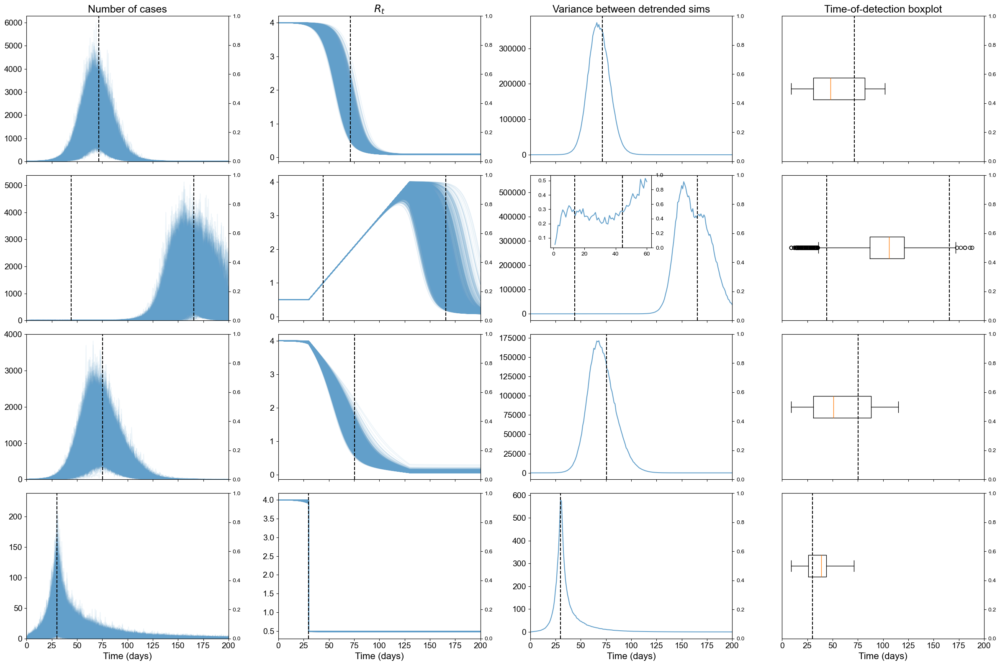

In [10]:
def norm(x):
    rolling_mean = x.expanding().mean()
    rolling_std = x.expanding().std(ddof=0)
    return (x-rolling_mean)/rolling_std

C_constant = np.diff(I_constant)
C_increasing = np.diff(I_increasing)
C_decreasing = np.diff(I_decreasing)
C_step = np.diff(I_step)

fig, axs = plt.subplots(nrows = 4, ncols = 4, figsize=(24,16),sharex=True)
for i in range(num_res):
    axs[0,0].plot(days[1:],df[i],color='#629FCA',alpha=0.1)
    axs[0,1].plot(times,Reff_constant[i],color='#629FCA',alpha=0.1)
axs[0,2].plot(days[1:],stoch_cst.var(axis=1).values,color='#629FCA',label='Simulation')
axs[0,3].boxplot([j for i in times_cst.values() for j in i],vert=False)

for ax in axs[0,:]:
    twin = ax.twinx()
    twin.vlines(constant_crit,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

for i in range(num_res_inc):
    axs[1,0].plot(days[1:],df_increasing[i],color='#629FCA',alpha=0.1)
    axs[1,1].plot(times,Reff_increasing[i],color='#629FCA',alpha=0.1)
axs[1,2].plot(days[1:],stoch_inc.var(axis=1).values,color='#629FCA')
axs[1,3].boxplot([j for i in times_inc.values() for j in i],vert=False)

for ax in axs[1,:]:
    twin = ax.twinx()
    twin.vlines(inc_crit_up,ymin=0,ymax=1,color='k',linestyle='--')
    twin.vlines(inc_crit_down,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

for i in range(num_res):
    axs[2,0].plot(days[1:],df_decreasing[i],color='#629FCA',alpha=0.1)
    axs[2,1].plot(times,Reff_decreasing[i],color='#629FCA',alpha=0.1)
axs[2,2].plot(days[1:],stoch_dec.var(axis=1).values,color='#629FCA')
axs[2,3].boxplot([j for i in times_dec.values() for j in i],vert=False)

for ax in axs[2,:]:
    twin = ax.twinx()
    twin.vlines(dec_crit,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

for i in range(num_res):
    axs[3,0].plot(days[1:],df_step[i],color='#629FCA',alpha=0.1)
    axs[3,1].plot(times,Reff_step[i],color='#629FCA',alpha=0.1)
axs[3,0].set_xlabel('Time (days)',fontsize=16)
axs[3,1].set_xlabel('Time (days)',fontsize=16)
axs[3,2].plot(days[1:],stoch_step.var(axis=1).values,color='#629FCA')
axs[3,2].set_xlabel('Time (days)',fontsize=16)  
axs[3,3].boxplot([j for i in times_step.values() for j in i],vert=False)
axs[3,3].set_xlabel('Time (days)',fontsize=16)

for ax in axs[3,:]:
    twin = ax.twinx()
    twin.vlines(step_crit,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

axs[0,0].set_title('Number of cases',fontsize=18)
axs[0,1].set_title(r'$R_t$',fontsize=18)
axs[0,2].set_title('Variance between detrended sims',fontsize=18)
axs[0,3].set_title('Time-of-detection boxplot',fontsize=18)

labels= [r'Constant $\beta(t)$',r'Increasing $\beta(t)$', r'Decreasing $\beta(t)$', r'Step decrease in $\beta(t)$']
for i in range(4):
    for j in range(4):
        axs[i,j].tick_params(axis='x', labelsize=14)
        axs[i,j].tick_params(axis='y', labelsize=14)
        if j == 3:
            axs[i,j].set_yticks([])
        if j == 0:
            axs[i,j].set_ylim((0,axs[i,j].get_ylim()[-1]))
        axs[i,j].set_xlim((0,200))
# for i in range(4):
#     axs[i,0].set_ylim([0,up_lims_p[i]])
#     axs[i,1].set_ylim([0,4.1])
#     axs[i,2].set_ylim([0,up_lims[i]])
#     axs[i,2].ticklabel_format(axis='y',style='sci',scilimits=(0,0))
#     axs[i,0].set_ylabel(labels[i],fontsize=18)
#     axs[i,0].get_yaxis().set_label_coords(-0.15,0.5)

iax = axs[1,2].inset_axes([0.1, 0.5, 0.5, 0.5])  # [left, bottom, width, height]
iax.plot(days[1:61],stoch_inc.var(axis=1).values[:60],color='#629FCA')
twin = iax.twinx()
twin.vlines(inc_crit_up,ymin=0,ymax=1,color='k',linestyle='--')
twin.set_ylim((0,1))

plt.tight_layout()
plt.savefig("Figures/cases_alpha_610.png",dpi=300,bbox_inches='tight')
plt.savefig("Figures/Tiffs/FigS5C.tiff", dpi=300, pil_kwargs={"compression": "tiff_lzw"})
plt.show()

In [16]:
num = 0
for i in range(len(times_inc)):
    if any(times_inc[i] <= inc_crit_up):
        num += 1
print(num / len(times_inc)) #0.15862857142857142
num = 0
for i in range(len(times_inc)):
    if any(times_inc[i] >= inc_crit_down) :
        num += 1
print(num / len(times_inc)) #0.006857142857142857

0.15862857142857142
0.006857142857142857


In [13]:
from scipy.stats import nbinom
rho = 0.6
phi = 0.01  # scalar overdispersion
n = phi
mu = np.diff(I_constant) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_cst = df.sub(df.mean(axis = 1), axis = 'rows')
mu = np.diff(I_step) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df_step = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_step = df_step.sub(df_step.mean(axis = 1), axis = 'rows')
mu = np.diff(I_increasing) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df_increasing = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_inc = df_increasing.sub(df_increasing.mean(axis = 1), axis = 'rows')
mu = np.diff(I_decreasing) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df_decreasing = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_dec = df_decreasing.sub(df_decreasing.mean(axis = 1), axis = 'rows')

In [ ]:
import pickle
if False:
    cst, cst_norm = calculate_ews_rolling(stoch_cst, 7)
    inc, inc_norm = calculate_ews_rolling(stoch_inc, 7)
    dec, dec_norm = calculate_ews_rolling(stoch_dec, 7)
    step, step_norm = calculate_ews_rolling(stoch_step, 7)

    ind_cst, mean_cst, std_cst = loop_EWSs_store_results_cutoffs(cst_norm,np.arange(num_res))
    ind_inc, mean_inc, std_inc = loop_EWSs_store_results_cutoffs(inc_norm,np.arange(num_res_inc))
    ind_dec, mean_dec, std_dec = loop_EWSs_store_results_cutoffs(dec_norm,np.arange(num_res))
    ind_step, mean_step, std_step = loop_EWSs_store_results_cutoffs(step_norm,np.arange(num_res))
    times_cst = {}
    times_inc = {}
    times_dec = {}
    times_step = {}

    for sim in np.arange(num_res):
        times_cst[sim] = detect(ind_cst['variance'][sim],days,3)
        times_dec[sim] = detect(ind_dec['variance'][sim],days,3)
        times_step[sim] = detect(ind_step['variance'][sim],days,3)

    for sim in np.arange(num_res_inc):
        times_inc[sim] = detect(ind_inc['variance'][sim],days,3)
    with open('Cases/times_const_alpha6001.pkl','wb') as output:
        pickle.dump(times_cst, output)
    with open('Cases/times_inc_alpha6001.pkl','wb') as output:
        pickle.dump(times_inc, output)
    with open('Cases/times_dec_alpha6001.pkl','wb') as output:
        pickle.dump(times_dec, output)
    with open('Cases/times_step_alpha6001.pkl','wb') as output:
        pickle.dump(times_step, output)
else:
    with open('Cases/times_const_alpha6001.pkl','rb') as output:
        times_cst = pickle.load(output)
    with open('Cases/times_inc_alpha6001.pkl','rb') as output:
        times_inc = pickle.load(output)
    with open('Cases/times_dec_alpha6001.pkl','rb') as output:
        times_dec = pickle.load(output)
    with open('Cases/times_step_alpha6001.pkl','rb') as output:
        times_step = pickle.load(output)

/tmp/ipykernel_86271/3963577503.py:6: RuntimeWarning: Mean of empty slice
  running_mean[j] = np.nanmean(standardised[1:j+1])
/home/jlooker/anaconda3/envs/mathsysbase/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/tmp/ipykernel_86271/3963577503.py:6: RuntimeWarning: Mean of empty slice
  running_mean[j] = np.nanmean(standardised[1:j+1])
/home/jlooker/anaconda3/envs/mathsysbase/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/tmp/ipykernel_86271/3963577503.py:6: RuntimeWarning: Mean of empty slice
  running_mean[j] = np.nanmean(standardised[1:j+1])
/home/jlooker/anaconda3/envs/mathsysbase/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtyp

/tmp/ipykernel_86271/3973935022.py:90: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


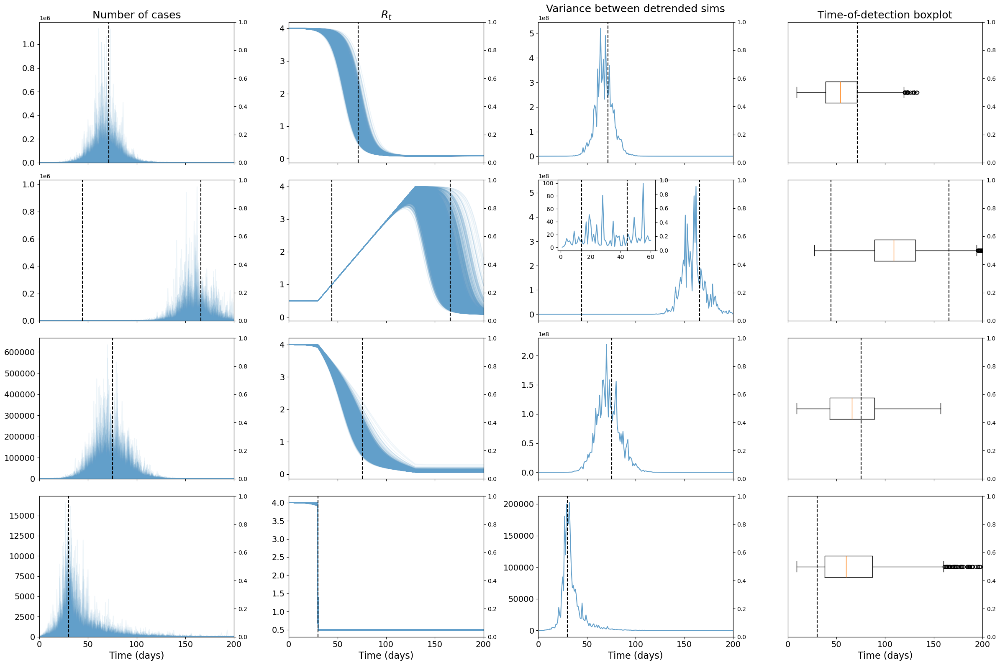

In [15]:
def norm(x):
    rolling_mean = x.expanding().mean()
    rolling_std = x.expanding().std(ddof=0)
    return (x-rolling_mean)/rolling_std

C_constant = np.diff(I_constant)
C_increasing = np.diff(I_increasing)
C_decreasing = np.diff(I_decreasing)
C_step = np.diff(I_step)

fig, axs = plt.subplots(nrows = 4, ncols = 4, figsize=(24,16),sharex=True)
for i in range(num_res):
    axs[0,0].plot(days[1:],df[i],color='#629FCA',alpha=0.1)
    axs[0,1].plot(times,Reff_constant[i],color='#629FCA',alpha=0.1)
axs[0,2].plot(days[1:],stoch_cst.var(axis=1).values,color='#629FCA',label='Simulation')
axs[0,3].boxplot([j for i in times_cst.values() for j in i],vert=False)

for ax in axs[0,:]:
    twin = ax.twinx()
    twin.vlines(constant_crit,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

for i in range(num_res_inc):
    axs[1,0].plot(days[1:],df_increasing[i],color='#629FCA',alpha=0.1)
    axs[1,1].plot(times,Reff_increasing[i],color='#629FCA',alpha=0.1)
axs[1,2].plot(days[1:],stoch_inc.var(axis=1).values,color='#629FCA')
axs[1,3].boxplot([j for i in times_inc.values() for j in i],vert=False)

for ax in axs[1,:]:
    twin = ax.twinx()
    twin.vlines(inc_crit_up,ymin=0,ymax=1,color='k',linestyle='--')
    twin.vlines(inc_crit_down,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

for i in range(num_res):
    axs[2,0].plot(days[1:],df_decreasing[i],color='#629FCA',alpha=0.1)
    axs[2,1].plot(times,Reff_decreasing[i],color='#629FCA',alpha=0.1)
axs[2,2].plot(days[1:],stoch_dec.var(axis=1).values,color='#629FCA')
axs[2,3].boxplot([j for i in times_dec.values() for j in i],vert=False)

for ax in axs[2,:]:
    twin = ax.twinx()
    twin.vlines(dec_crit,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

for i in range(num_res):
    axs[3,0].plot(days[1:],df_step[i],color='#629FCA',alpha=0.1)
    axs[3,1].plot(times,Reff_step[i],color='#629FCA',alpha=0.1)
axs[3,0].set_xlabel('Time (days)',fontsize=16)
axs[3,1].set_xlabel('Time (days)',fontsize=16)
axs[3,2].plot(days[1:],stoch_step.var(axis=1).values,color='#629FCA')
axs[3,2].set_xlabel('Time (days)',fontsize=16)  
axs[3,3].boxplot([j for i in times_step.values() for j in i],vert=False)
axs[3,3].set_xlabel('Time (days)',fontsize=16)

for ax in axs[3,:]:
    twin = ax.twinx()
    twin.vlines(step_crit,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

axs[0,0].set_title('Number of cases',fontsize=18)
axs[0,1].set_title(r'$R_t$',fontsize=18)
axs[0,2].set_title('Variance between detrended sims',fontsize=18)
axs[0,3].set_title('Time-of-detection boxplot',fontsize=18)

labels= [r'Constant $\beta(t)$',r'Increasing $\beta(t)$', r'Decreasing $\beta(t)$', r'Step decrease in $\beta(t)$']
for i in range(4):
    for j in range(4):
        axs[i,j].tick_params(axis='x', labelsize=14)
        axs[i,j].tick_params(axis='y', labelsize=14)
        if j == 3:
            axs[i,j].set_yticks([])
        if j == 0:
            axs[i,j].set_ylim((0,axs[i,j].get_ylim()[-1]))
        axs[i,j].set_xlim((0,200))
# for i in range(4):
#     axs[i,0].set_ylim([0,up_lims_p[i]])
#     axs[i,1].set_ylim([0,4.1])
#     axs[i,2].set_ylim([0,up_lims[i]])
#     axs[i,2].ticklabel_format(axis='y',style='sci',scilimits=(0,0))
#     axs[i,0].set_ylabel(labels[i],fontsize=18)
#     axs[i,0].get_yaxis().set_label_coords(-0.15,0.5)

iax = axs[1,2].inset_axes([0.1, 0.5, 0.5, 0.5])  # [left, bottom, width, height]
iax.plot(days[1:61],stoch_inc.var(axis=1).values[:60],color='#629FCA')
twin = iax.twinx()
twin.vlines(inc_crit_up,ymin=0,ymax=1,color='k',linestyle='--')
twin.set_ylim((0,1))

plt.tight_layout()
plt.savefig("Figures/cases_alpha_6001.png",dpi=300,bbox_inches='tight')
plt.show()

In [16]:
from scipy.stats import nbinom
rho = 0.6
phi = 0.1  # scalar overdispersion
n = phi
mu = np.diff(I_constant) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_cst = df.sub(df.mean(axis = 1), axis = 'rows')
mu = np.diff(I_step) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df_step = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_step = df_step.sub(df_step.mean(axis = 1), axis = 'rows')
mu = np.diff(I_increasing) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df_increasing = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_inc = df_increasing.sub(df_increasing.mean(axis = 1), axis = 'rows')
mu = np.diff(I_decreasing) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df_decreasing = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_dec = df_decreasing.sub(df_decreasing.mean(axis = 1), axis = 'rows')

In [ ]:
import pickle
if False:
    cst, cst_norm = calculate_ews_rolling(stoch_cst, 7)
    inc, inc_norm = calculate_ews_rolling(stoch_inc, 7)
    dec, dec_norm = calculate_ews_rolling(stoch_dec, 7)
    step, step_norm = calculate_ews_rolling(stoch_step, 7)

    ind_cst, mean_cst, std_cst = loop_EWSs_store_results_cutoffs(cst_norm,np.arange(num_res))
    ind_inc, mean_inc, std_inc = loop_EWSs_store_results_cutoffs(inc_norm,np.arange(num_res_inc))
    ind_dec, mean_dec, std_dec = loop_EWSs_store_results_cutoffs(dec_norm,np.arange(num_res))
    ind_step, mean_step, std_step = loop_EWSs_store_results_cutoffs(step_norm,np.arange(num_res))
    times_cst = {}
    times_inc = {}
    times_dec = {}
    times_step = {}

    for sim in np.arange(num_res):
        times_cst[sim] = detect(ind_cst['variance'][sim],days,3)
        times_dec[sim] = detect(ind_dec['variance'][sim],days,3)
        times_step[sim] = detect(ind_step['variance'][sim],days,3)

    for sim in np.arange(num_res_inc):
        times_inc[sim] = detect(ind_inc['variance'][sim],days,3)
    with open('Cases/times_const_alpha60_01.pkl','wb') as output:
        pickle.dump(times_cst, output)
    with open('Cases/times_inc_alpha60_01.pkl','wb') as output:
        pickle.dump(times_inc, output)
    with open('Cases/times_dec_alpha60_01.pkl','wb') as output:
        pickle.dump(times_dec, output)
    with open('Cases/times_step_alpha60_01.pkl','wb') as output:
        pickle.dump(times_step, output)
else:
    with open('Cases/times_const_alpha60_01.pkl','rb') as output:
        times_cst = pickle.load(output)
    with open('Cases/times_inc_alpha60_01.pkl','rb') as output:
        times_inc = pickle.load(output)
    with open('Cases/times_dec_alpha60_01.pkl','rb') as output:
        times_dec = pickle.load(output)
    with open('Cases/times_step_alpha60_01.pkl','rb') as output:
        times_step = pickle.load(output)

/tmp/ipykernel_86271/3963577503.py:6: RuntimeWarning: Mean of empty slice
  running_mean[j] = np.nanmean(standardised[1:j+1])
/home/jlooker/anaconda3/envs/mathsysbase/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/tmp/ipykernel_86271/3963577503.py:6: RuntimeWarning: Mean of empty slice
  running_mean[j] = np.nanmean(standardised[1:j+1])
/home/jlooker/anaconda3/envs/mathsysbase/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/tmp/ipykernel_86271/3963577503.py:6: RuntimeWarning: Mean of empty slice
  running_mean[j] = np.nanmean(standardised[1:j+1])
/home/jlooker/anaconda3/envs/mathsysbase/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtyp

/tmp/ipykernel_86271/1600968618.py:83: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


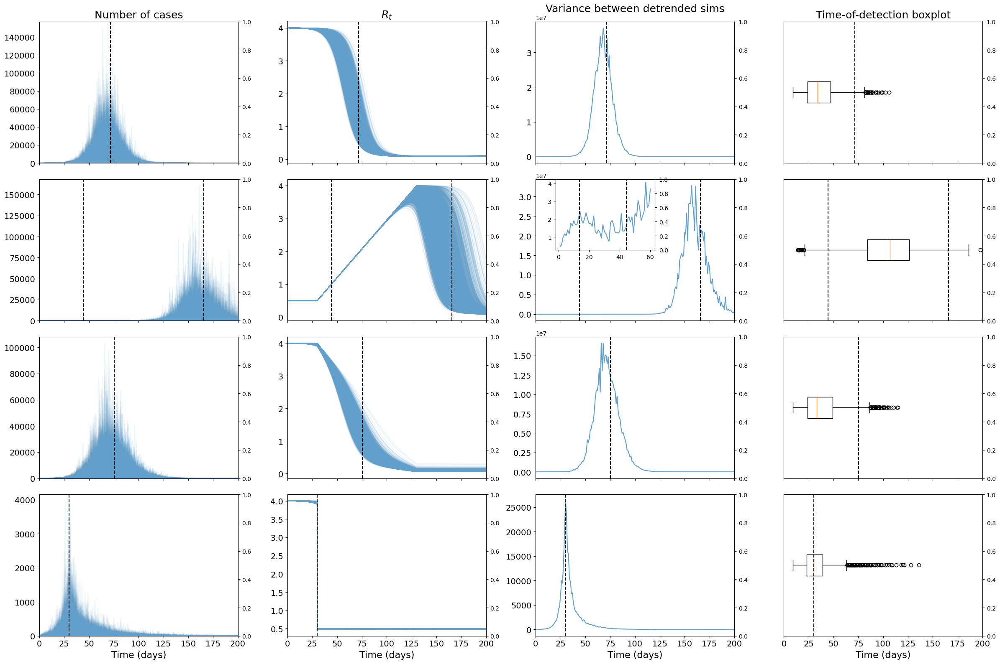

In [18]:
def norm(x):
    rolling_mean = x.expanding().mean()
    rolling_std = x.expanding().std(ddof=0)
    return (x-rolling_mean)/rolling_std

C_constant = np.diff(I_constant)
C_increasing = np.diff(I_increasing)
C_decreasing = np.diff(I_decreasing)
C_step = np.diff(I_step)

fig, axs = plt.subplots(nrows = 4, ncols = 4, figsize=(24,16),sharex=True)
for i in range(num_res):
    axs[0,0].plot(days[1:],df[i],color='#629FCA',alpha=0.1)
    axs[0,1].plot(times,Reff_constant[i],color='#629FCA',alpha=0.1)
axs[0,2].plot(days[1:],stoch_cst.var(axis=1).values,color='#629FCA',label='Simulation')
axs[0,3].boxplot([j for i in times_cst.values() for j in i],vert=False)

for ax in axs[0,:]:
    twin = ax.twinx()
    twin.vlines(constant_crit,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

for i in range(num_res_inc):
    axs[1,0].plot(days[1:],df_increasing[i],color='#629FCA',alpha=0.1)
    axs[1,1].plot(times,Reff_increasing[i],color='#629FCA',alpha=0.1)
axs[1,2].plot(days[1:],stoch_inc.var(axis=1).values,color='#629FCA')
axs[1,3].boxplot([j for i in times_inc.values() for j in i],vert=False)

for ax in axs[1,:]:
    twin = ax.twinx()
    twin.vlines(inc_crit_up,ymin=0,ymax=1,color='k',linestyle='--')
    twin.vlines(inc_crit_down,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

for i in range(num_res):
    axs[2,0].plot(days[1:],df_decreasing[i],color='#629FCA',alpha=0.1)
    axs[2,1].plot(times,Reff_decreasing[i],color='#629FCA',alpha=0.1)
axs[2,2].plot(days[1:],stoch_dec.var(axis=1).values,color='#629FCA')
axs[2,3].boxplot([j for i in times_dec.values() for j in i],vert=False)

for ax in axs[2,:]:
    twin = ax.twinx()
    twin.vlines(dec_crit,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

for i in range(num_res):
    axs[3,0].plot(days[1:],df_step[i],color='#629FCA',alpha=0.1)
    axs[3,1].plot(times,Reff_step[i],color='#629FCA',alpha=0.1)
axs[3,0].set_xlabel('Time (days)',fontsize=16)
axs[3,1].set_xlabel('Time (days)',fontsize=16)
axs[3,2].plot(days[1:],stoch_step.var(axis=1).values,color='#629FCA')
axs[3,2].set_xlabel('Time (days)',fontsize=16)  
axs[3,3].boxplot([j for i in times_step.values() for j in i],vert=False)
axs[3,3].set_xlabel('Time (days)',fontsize=16)

for ax in axs[3,:]:
    twin = ax.twinx()
    twin.vlines(step_crit,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

axs[0,0].set_title('Number of cases',fontsize=18)
axs[0,1].set_title(r'$R_t$',fontsize=18)
axs[0,2].set_title('Variance between detrended sims',fontsize=18)
axs[0,3].set_title('Time-of-detection boxplot',fontsize=18)

labels= [r'Constant $\beta(t)$',r'Increasing $\beta(t)$', r'Decreasing $\beta(t)$', r'Step decrease in $\beta(t)$']
for i in range(4):
    for j in range(4):
        axs[i,j].tick_params(axis='x', labelsize=14)
        axs[i,j].tick_params(axis='y', labelsize=14)
        if j == 3:
            axs[i,j].set_yticks([])
        if j == 0:
            axs[i,j].set_ylim((0,axs[i,j].get_ylim()[-1]))
        axs[i,j].set_xlim((0,200))

iax = axs[1,2].inset_axes([0.1, 0.5, 0.5, 0.5])  # [left, bottom, width, height]
iax.plot(days[1:61],stoch_inc.var(axis=1).values[:60],color='#629FCA')
twin = iax.twinx()
twin.vlines(inc_crit_up,ymin=0,ymax=1,color='k',linestyle='--')
twin.set_ylim((0,1))

plt.tight_layout()
plt.savefig("Figures/cases_alpha_60_01.png",dpi=300,bbox_inches='tight')
plt.show()

In [8]:
from scipy.stats import nbinom
rho = 0.8
phi = 10  # scalar overdispersion
n = phi
mu = np.diff(I_constant) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_cst = df.sub(df.mean(axis = 1), axis = 'rows')
mu = np.diff(I_step) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df_step = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_step = df_step.sub(df_step.mean(axis = 1), axis = 'rows')
mu = np.diff(I_increasing) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df_increasing = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_inc = df_increasing.sub(df_increasing.mean(axis = 1), axis = 'rows')
mu = np.diff(I_decreasing) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df_decreasing = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_dec = df_decreasing.sub(df_decreasing.mean(axis = 1), axis = 'rows')

In [9]:
import pickle
if False:
    cst, cst_norm = calculate_ews_rolling(stoch_cst, 7)
    inc, inc_norm = calculate_ews_rolling(stoch_inc, 7)
    dec, dec_norm = calculate_ews_rolling(stoch_dec, 7)
    step, step_norm = calculate_ews_rolling(stoch_step, 7)

    ind_cst, mean_cst, std_cst = loop_EWSs_store_results_cutoffs(cst_norm,np.arange(num_res))
    ind_inc, mean_inc, std_inc = loop_EWSs_store_results_cutoffs(inc_norm,np.arange(num_res_inc))
    ind_dec, mean_dec, std_dec = loop_EWSs_store_results_cutoffs(dec_norm,np.arange(num_res))
    ind_step, mean_step, std_step = loop_EWSs_store_results_cutoffs(step_norm,np.arange(num_res))
    times_cst = {}
    times_inc = {}
    times_dec = {}
    times_step = {}

    for sim in np.arange(num_res):
        times_cst[sim] = detect(ind_cst['variance'][sim],days,3)
        times_dec[sim] = detect(ind_dec['variance'][sim],days,3)
        times_step[sim] = detect(ind_step['variance'][sim],days,3)

    for sim in np.arange(num_res_inc):
        times_inc[sim] = detect(ind_inc['variance'][sim],days,3)
    with open('Cases/times_const_alpha810.pkl','wb') as output:
        pickle.dump(times_cst, output)
    with open('Cases/times_inc_alpha810.pkl','wb') as output:
        pickle.dump(times_inc, output)
    with open('Cases/times_dec_alpha810.pkl','wb') as output:
        pickle.dump(times_dec, output)
    with open('Cases/times_step_alpha810.pkl','wb') as output:
        pickle.dump(times_step, output)
else:
    with open('Cases/times_const_alpha810.pkl','rb') as output:
        times_cst = pickle.load(output)
    with open('Cases/times_inc_alpha810.pkl','rb') as output:
        times_inc = pickle.load(output)
    with open('Cases/times_dec_alpha810.pkl','rb') as output:
        times_dec = pickle.load(output)
    with open('Cases/times_step_alpha810.pkl','rb') as output:
        times_step = pickle.load(output)

/tmp/ipykernel_550204/339072212.py:83: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


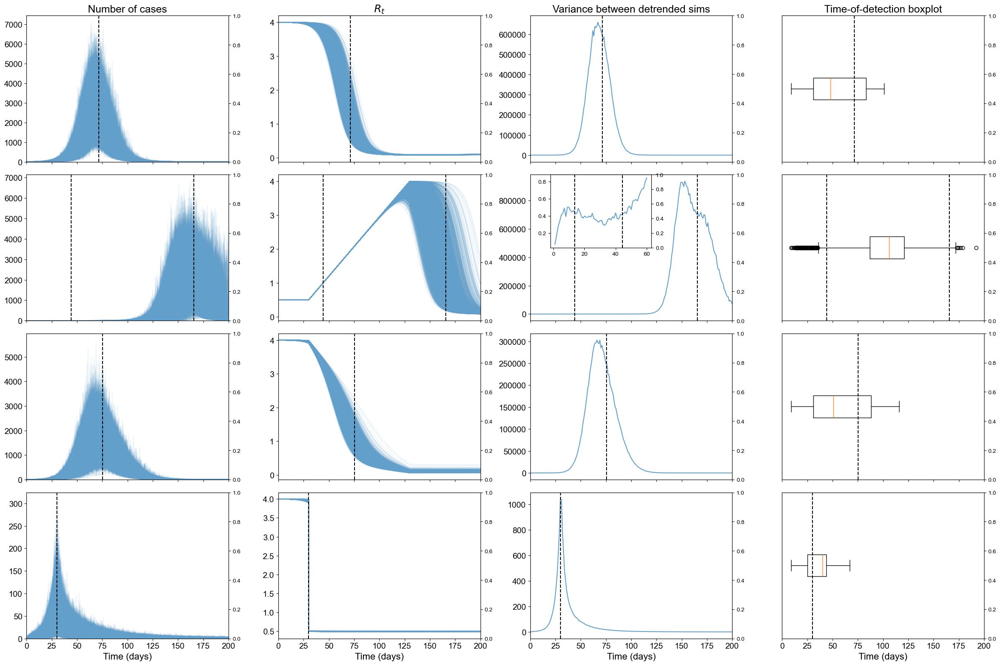

In [10]:
def norm(x):
    rolling_mean = x.expanding().mean()
    rolling_std = x.expanding().std(ddof=0)
    return (x-rolling_mean)/rolling_std

C_constant = np.diff(I_constant)
C_increasing = np.diff(I_increasing)
C_decreasing = np.diff(I_decreasing)
C_step = np.diff(I_step)

fig, axs = plt.subplots(nrows = 4, ncols = 4, figsize=(24,16),sharex=True)
for i in range(num_res):
    axs[0,0].plot(days[1:],df[i],color='#629FCA',alpha=0.1)
    axs[0,1].plot(times,Reff_constant[i],color='#629FCA',alpha=0.1)
axs[0,2].plot(days[1:],stoch_cst.var(axis=1).values,color='#629FCA',label='Simulation')
axs[0,3].boxplot([j for i in times_cst.values() for j in i],vert=False)

for ax in axs[0,:]:
    twin = ax.twinx()
    twin.vlines(constant_crit,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

for i in range(num_res_inc):
    axs[1,0].plot(days[1:],df_increasing[i],color='#629FCA',alpha=0.1)
    axs[1,1].plot(times,Reff_increasing[i],color='#629FCA',alpha=0.1)
axs[1,2].plot(days[1:],stoch_inc.var(axis=1).values,color='#629FCA')
axs[1,3].boxplot([j for i in times_inc.values() for j in i],vert=False)

for ax in axs[1,:]:
    twin = ax.twinx()
    twin.vlines(inc_crit_up,ymin=0,ymax=1,color='k',linestyle='--')
    twin.vlines(inc_crit_down,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

for i in range(num_res):
    axs[2,0].plot(days[1:],df_decreasing[i],color='#629FCA',alpha=0.1)
    axs[2,1].plot(times,Reff_decreasing[i],color='#629FCA',alpha=0.1)
axs[2,2].plot(days[1:],stoch_dec.var(axis=1).values,color='#629FCA')
axs[2,3].boxplot([j for i in times_dec.values() for j in i],vert=False)

for ax in axs[2,:]:
    twin = ax.twinx()
    twin.vlines(dec_crit,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

for i in range(num_res):
    axs[3,0].plot(days[1:],df_step[i],color='#629FCA',alpha=0.1)
    axs[3,1].plot(times,Reff_step[i],color='#629FCA',alpha=0.1)
axs[3,0].set_xlabel('Time (days)',fontsize=16)
axs[3,1].set_xlabel('Time (days)',fontsize=16)
axs[3,2].plot(days[1:],stoch_step.var(axis=1).values,color='#629FCA')
axs[3,2].set_xlabel('Time (days)',fontsize=16)  
axs[3,3].boxplot([j for i in times_step.values() for j in i],vert=False)
axs[3,3].set_xlabel('Time (days)',fontsize=16)

for ax in axs[3,:]:
    twin = ax.twinx()
    twin.vlines(step_crit,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

axs[0,0].set_title('Number of cases',fontsize=18)
axs[0,1].set_title(r'$R_t$',fontsize=18)
axs[0,2].set_title('Variance between detrended sims',fontsize=18)
axs[0,3].set_title('Time-of-detection boxplot',fontsize=18)

labels= [r'Constant $\beta(t)$',r'Increasing $\beta(t)$', r'Decreasing $\beta(t)$', r'Step decrease in $\beta(t)$']
for i in range(4):
    for j in range(4):
        axs[i,j].tick_params(axis='x', labelsize=14)
        axs[i,j].tick_params(axis='y', labelsize=14)
        if j == 3:
            axs[i,j].set_yticks([])
        if j == 0:
            axs[i,j].set_ylim((0,axs[i,j].get_ylim()[-1]))
        axs[i,j].set_xlim((0,200))

iax = axs[1,2].inset_axes([0.1, 0.5, 0.5, 0.5])  # [left, bottom, width, height]
iax.plot(days[1:61],stoch_inc.var(axis=1).values[:60],color='#629FCA')
twin = iax.twinx()
twin.vlines(inc_crit_up,ymin=0,ymax=1,color='k',linestyle='--')
twin.set_ylim((0,1))

plt.tight_layout()
#plt.savefig("Figures/cases_alpha_810.png",dpi=300,bbox_inches='tight')
plt.savefig("Figures/Tiffs/FigS5A.tiff", dpi=300, pil_kwargs={"compression": "tiff_lzw"})
plt.show()

In [7]:
from scipy.stats import nbinom
rho = 0.8
phi = 0.1  # scalar overdispersion
n = phi
mu = np.diff(I_constant) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_cst = df.sub(df.mean(axis = 1), axis = 'rows')
mu = np.diff(I_step) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df_step = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_step = df_step.sub(df_step.mean(axis = 1), axis = 'rows')
mu = np.diff(I_increasing) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df_increasing = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_inc = df_increasing.sub(df_increasing.mean(axis = 1), axis = 'rows')
mu = np.diff(I_decreasing) * rho  # shape: (10000, 200)
p = phi / (phi + mu)
df_decreasing = pd.DataFrame(nbinom.rvs(n=n, p=p, size=mu.shape, random_state=1)).T
stoch_dec = df_decreasing.sub(df_decreasing.mean(axis = 1), axis = 'rows')

In [8]:
import pickle
if False:
    cst, cst_norm = calculate_ews_rolling(stoch_cst, 7)
    inc, inc_norm = calculate_ews_rolling(stoch_inc, 7)
    dec, dec_norm = calculate_ews_rolling(stoch_dec, 7)
    step, step_norm = calculate_ews_rolling(stoch_step, 7)

    ind_cst, mean_cst, std_cst = loop_EWSs_store_results_cutoffs(cst_norm,np.arange(num_res))
    ind_inc, mean_inc, std_inc = loop_EWSs_store_results_cutoffs(inc_norm,np.arange(num_res_inc))
    ind_dec, mean_dec, std_dec = loop_EWSs_store_results_cutoffs(dec_norm,np.arange(num_res))
    ind_step, mean_step, std_step = loop_EWSs_store_results_cutoffs(step_norm,np.arange(num_res))
    times_cst = {}
    times_inc = {}
    times_dec = {}
    times_step = {}

    for sim in np.arange(num_res):
        times_cst[sim] = detect(ind_cst['variance'][sim],days,3)
        times_dec[sim] = detect(ind_dec['variance'][sim],days,3)
        times_step[sim] = detect(ind_step['variance'][sim],days,3)

    for sim in np.arange(num_res_inc):
        times_inc[sim] = detect(ind_inc['variance'][sim],days,3)
    with open('Cases/times_const_alpha80_01.pkl','wb') as output:
        pickle.dump(times_cst, output)
    with open('Cases/times_inc_alpha80_01.pkl','wb') as output:
        pickle.dump(times_inc, output)
    with open('Cases/times_dec_alpha80_01.pkl','wb') as output:
        pickle.dump(times_dec, output)
    with open('Cases/times_step_alpha80_01.pkl','wb') as output:
        pickle.dump(times_step, output)
else:
    with open('Cases/times_const_alpha80_01.pkl','rb') as output:
        times_cst = pickle.load(output)
    with open('Cases/times_inc_alpha80_01.pkl','rb') as output:
        times_inc = pickle.load(output)
    with open('Cases/times_dec_alpha80_01.pkl','rb') as output:
        times_dec = pickle.load(output)
    with open('Cases/times_step_alpha80_01.pkl','rb') as output:
        times_step = pickle.load(output)

/tmp/ipykernel_86886/565206375.py:83: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


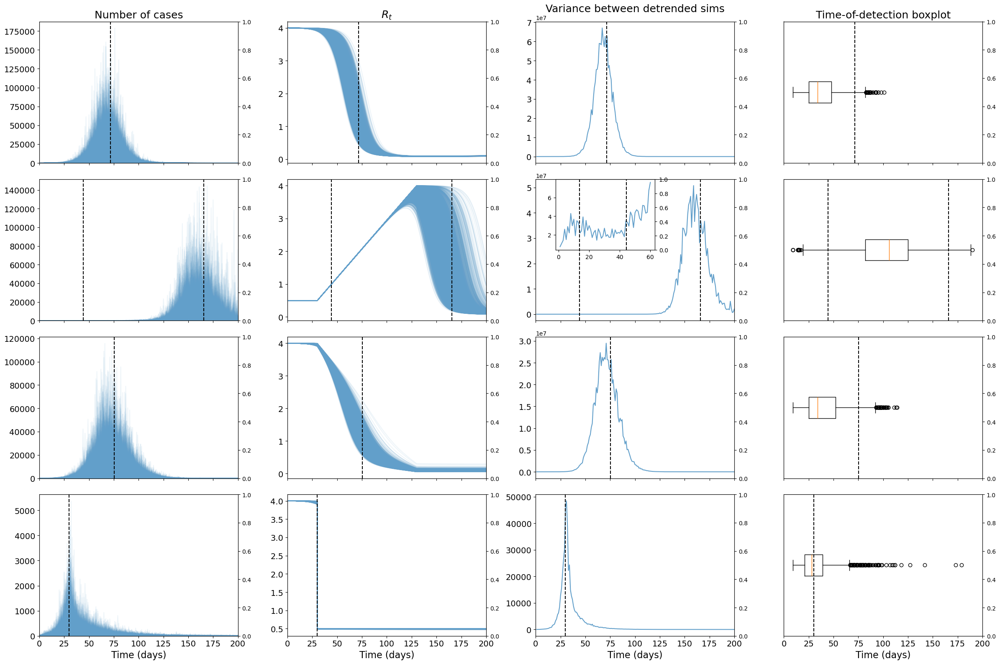

In [11]:
def norm(x):
    rolling_mean = x.expanding().mean()
    rolling_std = x.expanding().std(ddof=0)
    return (x-rolling_mean)/rolling_std

C_constant = np.diff(I_constant)
C_increasing = np.diff(I_increasing)
C_decreasing = np.diff(I_decreasing)
C_step = np.diff(I_step)

fig, axs = plt.subplots(nrows = 4, ncols = 4, figsize=(24,16),sharex=True)
for i in range(num_res):
    axs[0,0].plot(days[1:],df[i],color='#629FCA',alpha=0.1)
    axs[0,1].plot(times,Reff_constant[i],color='#629FCA',alpha=0.1)
axs[0,2].plot(days[1:],stoch_cst.var(axis=1).values,color='#629FCA',label='Simulation')
axs[0,3].boxplot([j for i in times_cst.values() for j in i],vert=False)

for ax in axs[0,:]:
    twin = ax.twinx()
    twin.vlines(constant_crit,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

for i in range(num_res_inc):
    axs[1,0].plot(days[1:],df_increasing[i],color='#629FCA',alpha=0.1)
    axs[1,1].plot(times,Reff_increasing[i],color='#629FCA',alpha=0.1)
axs[1,2].plot(days[1:],stoch_inc.var(axis=1).values,color='#629FCA')
axs[1,3].boxplot([j for i in times_inc.values() for j in i],vert=False)

for ax in axs[1,:]:
    twin = ax.twinx()
    twin.vlines(inc_crit_up,ymin=0,ymax=1,color='k',linestyle='--')
    twin.vlines(inc_crit_down,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

for i in range(num_res):
    axs[2,0].plot(days[1:],df_decreasing[i],color='#629FCA',alpha=0.1)
    axs[2,1].plot(times,Reff_decreasing[i],color='#629FCA',alpha=0.1)
axs[2,2].plot(days[1:],stoch_dec.var(axis=1).values,color='#629FCA')
axs[2,3].boxplot([j for i in times_dec.values() for j in i],vert=False)

for ax in axs[2,:]:
    twin = ax.twinx()
    twin.vlines(dec_crit,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

for i in range(num_res):
    axs[3,0].plot(days[1:],df_step[i],color='#629FCA',alpha=0.1)
    axs[3,1].plot(times,Reff_step[i],color='#629FCA',alpha=0.1)
axs[3,0].set_xlabel('Time (days)',fontsize=16)
axs[3,1].set_xlabel('Time (days)',fontsize=16)
axs[3,2].plot(days[1:],stoch_step.var(axis=1).values,color='#629FCA')
axs[3,2].set_xlabel('Time (days)',fontsize=16)  
axs[3,3].boxplot([j for i in times_step.values() for j in i],vert=False)
axs[3,3].set_xlabel('Time (days)',fontsize=16)

for ax in axs[3,:]:
    twin = ax.twinx()
    twin.vlines(step_crit,ymin=0,ymax=1,color='k',linestyle='--')
    twin.set_ylim((0,1))

axs[0,0].set_title('Number of cases',fontsize=18)
axs[0,1].set_title(r'$R_t$',fontsize=18)
axs[0,2].set_title('Variance between detrended sims',fontsize=18)
axs[0,3].set_title('Time-of-detection boxplot',fontsize=18)

labels= [r'Constant $\beta(t)$',r'Increasing $\beta(t)$', r'Decreasing $\beta(t)$', r'Step decrease in $\beta(t)$']
for i in range(4):
    for j in range(4):
        axs[i,j].tick_params(axis='x', labelsize=14)
        axs[i,j].tick_params(axis='y', labelsize=14)
        if j == 3:
            axs[i,j].set_yticks([])
        if j == 0:
            axs[i,j].set_ylim((0,axs[i,j].get_ylim()[-1]))
        axs[i,j].set_xlim((0,200))

iax = axs[1,2].inset_axes([0.1, 0.5, 0.5, 0.5])  # [left, bottom, width, height]
iax.plot(days[1:61],stoch_inc.var(axis=1).values[:60],color='#629FCA')
twin = iax.twinx()
twin.vlines(inc_crit_up,ymin=0,ymax=1,color='k',linestyle='--')
twin.set_ylim((0,1))

plt.tight_layout()
plt.savefig("Figures/cases_alpha_80_01.png",dpi=300,bbox_inches='tight')
plt.show()